In [6]:
import numpy as np
import torch
import gymnasium as gym
import random

from scripts.sac import *
from scripts.action_embedding_net import *
from scripts.save_everything import *
from scripts.load_everything import *
from scripts.generate_everything import *


# Make environment deterministic for reproducibility
def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True

set_seed(42)

# Use GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Create the environment
env_name = "HalfCheetah-v4"
env = gym.make(env_name)
env.action_space.seed(42)
env.reset(seed=42)

Using device: cpu


(array([-0.01222431,  0.07171958,  0.03947361, -0.08116453,  0.09512447,
         0.05222794,  0.05721286, -0.07437727, -0.08530439,  0.0879398 ,
         0.07777919,  0.00660307,  0.11272412,  0.04675093, -0.08592925,
         0.03687508, -0.09588826]),
 {})

# RL train expert policy

  0%|          | 0/1500 [00:00<?, ?it/s]

Episode: 10, Avg. Reward: -241.55
Saved episode 10 model
Episode: 20, Avg. Reward: -169.70
Saved episode 20 model
Episode: 30, Avg. Reward: -61.14
Saved episode 30 model
Episode: 40, Avg. Reward: 238.87
Saved episode 40 model
Episode: 50, Avg. Reward: 840.83
Saved episode 50 model
Episode: 60, Avg. Reward: 976.65
Saved episode 60 model
Episode: 70, Avg. Reward: 994.75
Saved episode 70 model
Episode: 80, Avg. Reward: 976.79
Saved episode 80 model
Episode: 90, Avg. Reward: 954.10
Saved episode 90 model
Episode: 100, Avg. Reward: 1005.01
Saved episode 100 model
Episode: 110, Avg. Reward: 1232.30
Saved episode 110 model
Episode: 120, Avg. Reward: 1287.99
Saved episode 120 model
Episode: 130, Avg. Reward: 1337.70
Saved episode 130 model
Episode: 140, Avg. Reward: 1374.84
Saved episode 140 model
Episode: 150, Avg. Reward: 1285.23
Saved episode 150 model
Episode: 160, Avg. Reward: 1387.01
Saved episode 160 model
Episode: 170, Avg. Reward: 1442.36
Saved episode 170 model
Episode: 180, Avg. Rew

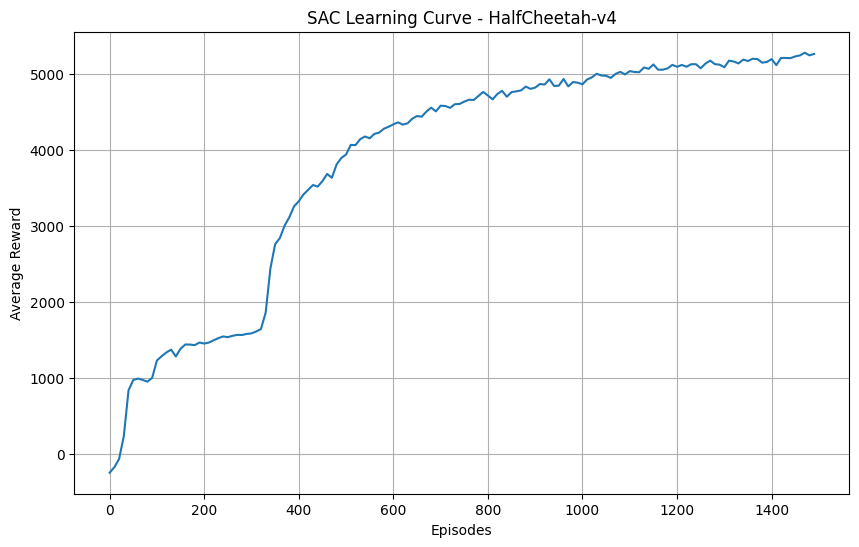

Total reward: 5799.12


Animation size has reached 20991501 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


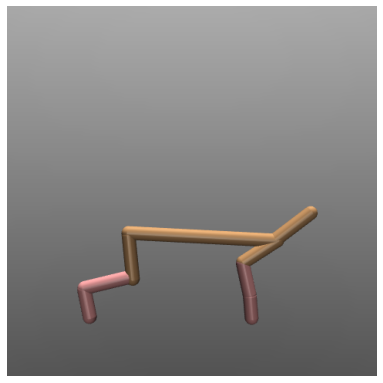

In [7]:
state_dim = env.observation_space.shape[0]
action_dim = env.action_space.shape[0]
    
agent = SAC(
    state_dim=state_dim,
    action_dim=action_dim,
    action_space=env.action_space,
    lr=3e-4,
    hidden_dim=256,
    buffer_size=1000000,
    batch_size=256,
    tau=0.005,
    gamma=0.99,
    alpha=0.2,
    auto_entropy_tuning=True
    )
    
# Training parameters
num_episodes = 1500
max_steps = 2000
eval_interval = 10
record_interval = 10
    
# Train the agent
#episode_rewards, avg_rewards = train(env_name, agent, num_episodes, max_steps, eval_interval)
episode_rewards, avg_wards = train_record(env_name, agent, num_episodes, max_steps, record_interval=10)
    
# Render and save GIF of the trained policy
frames = render_policy(env_name, agent, save_path='./figures/halfcheetah.gif')

# save the expert policy

In [8]:
if not os.path.exists('./models'):
    os.makedirs('./models')
    
model_save_dir = './models'
# Save the trained policy
agent.save(model_save_dir, "sac_" + env_name )

# create expert trajectories as offline dataset

In [10]:
agent = load_agent(env, model_save_dir + "/sac_" + env_name)

Loaded trained SAC agent


In [11]:
    
trajectories, offline_dataset = generate_expert_trajectories(env, agent, num_trajectories=500, max_steps=max_steps)
    
save_data(trajectories, offline_dataset, save_dir='./expert_data')

Generating expert trajectories:   0%|          | 0/500 [00:00<?, ?it/s]

/Users/williams/anaconda3/envs/rl/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Trajectory 11: 1000 steps
Trajectory 12: 1000 steps
Trajectory 13: 1000 steps
Trajectory 14: 1000 steps
Trajectory 15: 1000 steps
Trajectory 16: 1000 steps
Trajectory 17: 1000 steps
Trajectory 18: 1000 steps
Trajectory 19: 1000 steps
Trajectory 20: 1000 steps
Trajectory 21: 1000 steps
Trajectory 22: 1000 steps
Trajectory 23: 1000 steps
Trajectory 24: 1000 steps
Trajectory 25: 1000 steps
Trajectory 26: 1000 steps
Trajectory 27: 1000 steps
Trajectory 28: 1000 steps
Trajectory 29: 1000 steps
Trajectory 30: 1000 steps
Trajectory 31: 1000 steps
Trajectory 32: 1000 steps
Trajectory 33: 1000 steps
Trajectory 34: 1000 steps
Trajectory 35: 1000 steps
Trajectory 36: 1000 steps
Trajectory 37: 1000 steps
Trajectory 38: 1000 steps
Trajectory 39: 1000 s

# word2vec network

Loading offline dataset...
Loaded dataset with 500000 transitions
State dimension: 17
Action dimension: 6

Training embedding networks...


Epoch 1/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 2/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 3/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 4/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 5/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 6/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 7/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 8/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 9/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 10/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 10/50, SA Loss: 0.0110, A Loss: 0.0294


Epoch 11/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 12/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 13/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 14/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 15/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 16/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 17/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 18/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 19/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 20/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 20/50, SA Loss: 0.0087, A Loss: 0.0270


Epoch 21/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 22/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 23/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 24/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 25/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 26/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 27/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 28/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 29/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 30/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 30/50, SA Loss: 0.0077, A Loss: 0.0260


Epoch 31/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 32/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 33/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 34/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 35/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 36/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 37/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 38/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 39/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 40/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 40/50, SA Loss: 0.0070, A Loss: 0.0258


Epoch 41/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 42/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 43/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 44/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 45/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 46/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 47/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 48/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 49/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 50/50:   0%|          | 0/1954 [00:00<?, ?it/s]

Epoch 50/50, SA Loss: 0.0067, A Loss: 0.0253


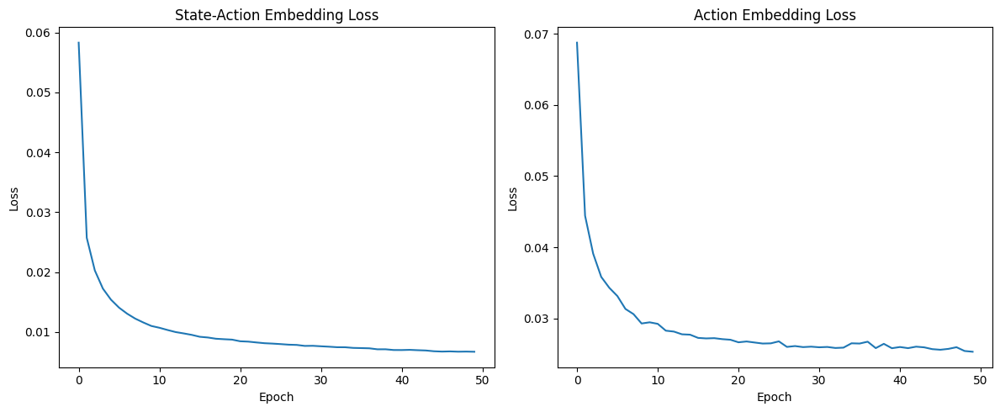

In [12]:
# Load dataset
print("Loading offline dataset...")
dataset = load_offline_dataset(filename='./expert_data/halfcheetah_expert_dataset.pkl')
print(f"Loaded dataset with {len(dataset['states'])} transitions")
    
# Get dimensions
state_dim = dataset['states'].shape[1]
action_dim = dataset['actions'].shape[1]
    
print(f"State dimension: {state_dim}")
print(f"Action dimension: {action_dim}")
    
# Train embedding networks
print("\nTraining embedding networks...")
sa_embedding, a_embedding, sa_losses, a_losses = train_embeddings(
    dataset, 
    state_dim=state_dim, 
    action_dim=action_dim,
    epochs=50,
    batch_size=256,
    lr=1e-3
)


Generating embeddings for all data points...

Visualizing embeddings...


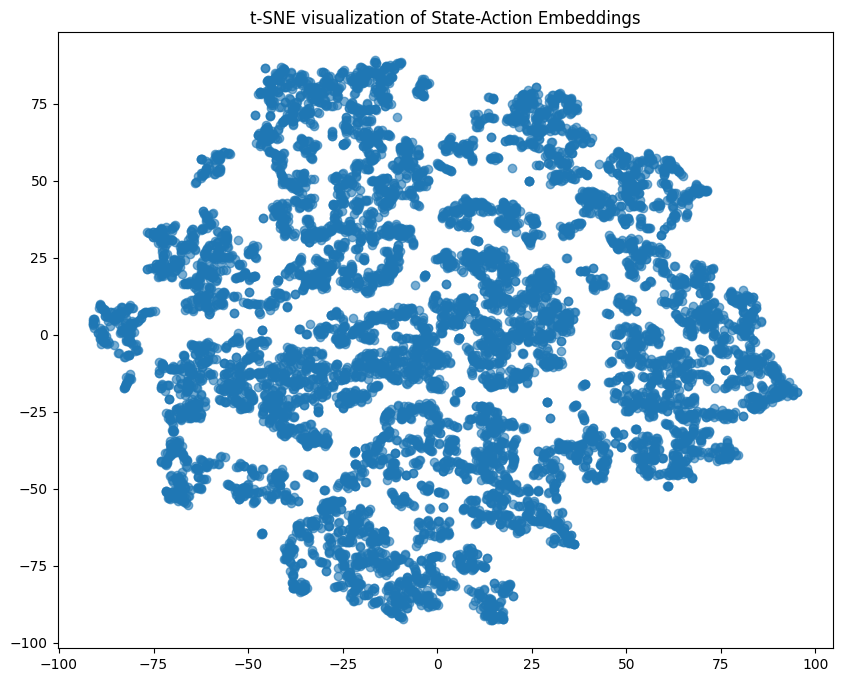

In [15]:
# Generate embeddings for all data points
print("\nGenerating embeddings for all data points...")
sa_embeddings, a_embeddings = generate_all_embeddings(dataset, sa_embedding, a_embedding)

# Visualize embeddings
print("\nVisualizing embeddings...")
visualize_embeddings(sa_embeddings, "State-Action Embeddings", n_samples=10000)
#visualize_embeddings(a_embeddings, "Action Embeddings", n_samples=10000)

In [16]:
# Save models
save_embedding_models(sa_embedding, a_embedding, directory='./models')

# Save embeddings
save_embeddings(sa_embeddings, a_embeddings, directory='./embeddings')

Saved embedding models to ./models
Saved embeddings to ./embeddings


# SA embedding evolution

In [ ]:
state_action_model, action_model = load_embedding_models(state_dim, action_dim)

# load every model in dir tracking and for each model generate 10 trajectories
for filename in os.listdir("tracking"):
    if filename.endswith('.pth'):
        agent = SAC(
            state_dim = env.observation_space.shape[0],
            action_dim = env.action_space.shape[0],
            action_space=env.action_space,
            lr=3e-4,
            hidden_dim=256,
            buffer_size=1000000,
            batch_size=256,
            tau=0.005,
            gamma=0.99,
            alpha=0.2,
            auto_entropy_tuning=True
        )
        agent = load_agent(env, os.path.join("tracking", filename))
        print(f"Loaded model: {filename}")
        
        # Generate trajectories
        trajectories, offline_dataset = generate_expert_trajectories(env, agent, num_trajectories=10, max_steps=max_steps)
        #print(f"Generated trajectories for model: {filename}")
        sa_embeddings, a_embeddings = generate_all_embeddings(offline_dataset, state_action_model, action_model)
        #print(f"Generated embeddings for model: {filename}")
        # Save the embeddings
        save_embeddings(sa_embeddings, a_embeddings, directory="tracking_embeddings", prefix=filename[:-4])
        #print(f"Saved embeddings for model: {filename}")


Loaded embedding models from ./models
Loaded trained SAC agent
Loaded model: episode_30.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_30.pth
Generated embeddings for model: episode_30.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_30.pth
Loaded trained SAC agent
Loaded model: episode_930.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_930.pth
Generated embeddings for model: episode_930.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_930.pth
Loaded trained SAC agent
Loaded model: episode_850.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_850.pth
Generated embeddings for model: episode_850.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_850.pth
Loaded trained SAC agent
Loaded model: episode_1270.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1270.pth
Generated embeddings for model: episode_1270.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1270.pth
Loaded trained SAC agent
Loaded model: episode_110.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_110.pth
Generated embeddings for model: episode_110.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_110.pth
Loaded trained SAC agent
Loaded model: episode_460.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_460.pth
Generated embeddings for model: episode_460.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_460.pth
Loaded trained SAC agent
Loaded model: episode_500.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_500.pth
Generated embeddings for model: episode_500.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_500.pth
Loaded trained SAC agent
Loaded model: episode_1310.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1310.pth
Generated embeddings for model: episode_1310.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1310.pth
Loaded trained SAC agent
Loaded model: episode_1460.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1460.pth
Generated embeddings for model: episode_1460.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1460.pth
Loaded trained SAC agent
Loaded model: episode_700.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_700.pth
Generated embeddings for model: episode_700.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_700.pth
Loaded trained SAC agent
Loaded model: episode_270.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_270.pth
Generated embeddings for model: episode_270.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_270.pth
Loaded trained SAC agent
Loaded model: episode_1110.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1110.pth
Generated embeddings for model: episode_1110.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1110.pth
Loaded trained SAC agent
Loaded model: episode_1070.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1070.pth
Generated embeddings for model: episode_1070.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1070.pth
Loaded trained SAC agent
Loaded model: episode_310.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_310.pth
Generated embeddings for model: episode_310.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_310.pth
Loaded trained SAC agent
Loaded model: episode_660.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_660.pth
Generated embeddings for model: episode_660.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_660.pth
Loaded trained SAC agent
Loaded model: episode_1500.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1500.pth
Generated embeddings for model: episode_1500.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1500.pth
Loaded trained SAC agent
Loaded model: episode_890.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_890.pth
Generated embeddings for model: episode_890.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_890.pth
Loaded trained SAC agent
Loaded model: episode_670.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_670.pth
Generated embeddings for model: episode_670.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_670.pth
Loaded trained SAC agent
Loaded model: episode_880.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_880.pth
Generated embeddings for model: episode_880.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_880.pth
Loaded trained SAC agent
Loaded model: episode_1060.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1060.pth
Generated embeddings for model: episode_1060.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1060.pth
Loaded trained SAC agent
Loaded model: episode_300.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_300.pth
Generated embeddings for model: episode_300.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_300.pth
Loaded trained SAC agent
Loaded model: episode_260.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_260.pth
Generated embeddings for model: episode_260.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_260.pth
Loaded trained SAC agent
Loaded model: episode_1100.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1100.pth
Generated embeddings for model: episode_1100.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1100.pth
Loaded trained SAC agent
Loaded model: episode_1470.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1470.pth
Generated embeddings for model: episode_1470.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1470.pth
Loaded trained SAC agent
Loaded model: episode_710.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_710.pth
Generated embeddings for model: episode_710.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_710.pth
Loaded trained SAC agent
Loaded model: episode_1300.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1300.pth
Generated embeddings for model: episode_1300.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1300.pth
Loaded trained SAC agent
Loaded model: episode_510.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_510.pth
Generated embeddings for model: episode_510.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_510.pth
Loaded trained SAC agent
Loaded model: episode_470.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_470.pth
Generated embeddings for model: episode_470.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_470.pth
Loaded trained SAC agent
Loaded model: episode_1260.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1260.pth
Generated embeddings for model: episode_1260.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1260.pth
Loaded trained SAC agent
Loaded model: episode_100.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_100.pth
Generated embeddings for model: episode_100.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_100.pth
Loaded trained SAC agent
Loaded model: episode_840.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_840.pth
Generated embeddings for model: episode_840.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_840.pth
Loaded trained SAC agent
Loaded model: episode_20.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_20.pth
Generated embeddings for model: episode_20.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_20.pth
Loaded trained SAC agent
Loaded model: episode_920.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_920.pth
Generated embeddings for model: episode_920.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_920.pth
Loaded trained SAC agent
Loaded model: episode_760.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_760.pth
Generated embeddings for model: episode_760.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_760.pth
Loaded trained SAC agent
Loaded model: episode_1400.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1400.pth
Generated embeddings for model: episode_1400.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1400.pth
Loaded trained SAC agent
Loaded model: episode_90.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_90.pth
Generated embeddings for model: episode_90.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_90.pth
Loaded trained SAC agent
Loaded model: episode_990.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_990.pth
Generated embeddings for model: episode_990.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_990.pth
Loaded trained SAC agent
Loaded model: episode_1170.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1170.pth
Generated embeddings for model: episode_1170.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1170.pth
Loaded trained SAC agent
Loaded model: episode_210.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_210.pth
Generated embeddings for model: episode_210.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_210.pth
Loaded trained SAC agent
Loaded model: episode_370.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_370.pth
Generated embeddings for model: episode_370.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_370.pth
Loaded trained SAC agent
Loaded model: episode_1010.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1010.pth
Generated embeddings for model: episode_1010.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1010.pth
Loaded trained SAC agent
Loaded model: episode_600.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_600.pth
Generated embeddings for model: episode_600.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_600.pth
Loaded trained SAC agent
Loaded model: episode_50.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_50.pth
Generated embeddings for model: episode_50.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_50.pth
Loaded trained SAC agent
Loaded model: episode_950.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_950.pth
Generated embeddings for model: episode_950.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_950.pth
Loaded trained SAC agent
Loaded model: episode_830.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_830.pth
Generated embeddings for model: episode_830.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_830.pth
Loaded trained SAC agent
Loaded model: episode_170.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_170.pth
Generated embeddings for model: episode_170.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_170.pth
Loaded trained SAC agent
Loaded model: episode_1210.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1210.pth
Generated embeddings for model: episode_1210.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1210.pth
Loaded trained SAC agent
Loaded model: episode_400.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_400.pth
Generated embeddings for model: episode_400.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_400.pth
Loaded trained SAC agent
Loaded model: episode_560.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_560.pth
Generated embeddings for model: episode_560.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_560.pth
Loaded trained SAC agent
Loaded model: episode_1370.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1370.pth
Generated embeddings for model: episode_1370.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1370.pth
Loaded trained SAC agent
Loaded model: episode_1360.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1360.pth
Generated embeddings for model: episode_1360.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1360.pth
Loaded trained SAC agent
Loaded model: episode_570.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_570.pth
Generated embeddings for model: episode_570.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_570.pth
Loaded trained SAC agent
Loaded model: episode_410.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_410.pth
Generated embeddings for model: episode_410.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_410.pth
Loaded trained SAC agent
Loaded model: episode_160.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_160.pth
Generated embeddings for model: episode_160.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_160.pth
Loaded trained SAC agent
Loaded model: episode_1200.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1200.pth
Generated embeddings for model: episode_1200.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1200.pth
Loaded trained SAC agent
Loaded model: episode_820.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_820.pth
Generated embeddings for model: episode_820.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_820.pth
Loaded trained SAC agent
Loaded model: episode_40.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_40.pth
Generated embeddings for model: episode_40.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_40.pth
Loaded trained SAC agent
Loaded model: episode_940.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_940.pth
Generated embeddings for model: episode_940.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_940.pth
Loaded trained SAC agent
Loaded model: episode_610.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_610.pth
Generated embeddings for model: episode_610.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_610.pth
Loaded trained SAC agent
Loaded model: episode_360.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_360.pth
Generated embeddings for model: episode_360.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_360.pth
Loaded trained SAC agent
Loaded model: episode_1000.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1000.pth
Generated embeddings for model: episode_1000.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1000.pth
Loaded trained SAC agent
Loaded model: episode_1160.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1160.pth
Generated embeddings for model: episode_1160.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1160.pth
Loaded trained SAC agent
Loaded model: episode_200.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_200.pth
Generated embeddings for model: episode_200.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_200.pth
Loaded trained SAC agent
Loaded model: episode_770.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_770.pth
Generated embeddings for model: episode_770.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_770.pth
Loaded trained SAC agent
Loaded model: episode_1410.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1410.pth
Generated embeddings for model: episode_1410.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1410.pth
Loaded trained SAC agent
Loaded model: episode_80.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_80.pth
Generated embeddings for model: episode_80.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_80.pth
Loaded trained SAC agent
Loaded model: episode_980.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_980.pth
Generated embeddings for model: episode_980.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_980.pth
Loaded trained SAC agent
Loaded model: episode_1390.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1390.pth
Generated embeddings for model: episode_1390.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1390.pth
Loaded trained SAC agent
Loaded model: episode_580.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_580.pth
Generated embeddings for model: episode_580.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_580.pth
Loaded trained SAC agent
Loaded model: episode_190.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_190.pth
Generated embeddings for model: episode_190.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_190.pth
Loaded trained SAC agent
Loaded model: episode_620.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_620.pth
Generated embeddings for model: episode_620.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_620.pth
Loaded trained SAC agent
Loaded model: episode_1030.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1030.pth
Generated embeddings for model: episode_1030.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1030.pth
Loaded trained SAC agent
Loaded model: episode_350.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_350.pth
Generated embeddings for model: episode_350.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_350.pth
Loaded trained SAC agent
Loaded model: episode_230.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_230.pth
Generated embeddings for model: episode_230.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_230.pth
Loaded trained SAC agent
Loaded model: episode_1150.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1150.pth
Generated embeddings for model: episode_1150.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1150.pth
Loaded trained SAC agent
Loaded model: episode_1420.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1420.pth
Generated embeddings for model: episode_1420.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1420.pth
Loaded trained SAC agent
Loaded model: episode_740.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_740.pth
Generated embeddings for model: episode_740.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_740.pth
Loaded trained SAC agent
Loaded model: episode_1350.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1350.pth
Generated embeddings for model: episode_1350.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1350.pth
Loaded trained SAC agent
Loaded model: episode_540.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_540.pth
Generated embeddings for model: episode_540.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_540.pth
Loaded trained SAC agent
Loaded model: episode_420.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_420.pth
Generated embeddings for model: episode_420.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_420.pth
Loaded trained SAC agent
Loaded model: episode_1230.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1230.pth
Generated embeddings for model: episode_1230.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1230.pth
Loaded trained SAC agent
Loaded model: episode_150.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_150.pth
Generated embeddings for model: episode_150.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_150.pth
Loaded trained SAC agent
Loaded model: episode_810.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_810.pth
Generated embeddings for model: episode_810.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_810.pth
Loaded trained SAC agent
Loaded model: episode_390.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_390.pth
Generated embeddings for model: episode_390.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_390.pth
Loaded trained SAC agent
Loaded model: episode_1190.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1190.pth
Generated embeddings for model: episode_1190.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1190.pth
Loaded trained SAC agent
Loaded model: episode_970.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_970.pth
Generated embeddings for model: episode_970.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_970.pth
Loaded trained SAC agent
Loaded model: episode_780.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_780.pth
Generated embeddings for model: episode_780.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_780.pth
Loaded trained SAC agent
Loaded model: episode_70.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_70.pth
Generated embeddings for model: episode_70.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_70.pth
Loaded trained SAC agent
Loaded model: episode_960.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_960.pth
Generated embeddings for model: episode_960.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_960.pth
Loaded trained SAC agent
Loaded model: episode_790.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_790.pth
Generated embeddings for model: episode_790.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_790.pth
Loaded trained SAC agent
Loaded model: episode_60.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_60.pth
Generated embeddings for model: episode_60.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_60.pth
Loaded trained SAC agent
Loaded model: episode_1180.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1180.pth
Generated embeddings for model: episode_1180.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1180.pth
Loaded trained SAC agent
Loaded model: episode_380.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_380.pth
Generated embeddings for model: episode_380.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_380.pth
Loaded trained SAC agent
Loaded model: episode_800.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_800.pth
Generated embeddings for model: episode_800.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_800.pth
Loaded trained SAC agent
Loaded model: episode_1220.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1220.pth
Generated embeddings for model: episode_1220.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1220.pth
Loaded trained SAC agent
Loaded model: episode_140.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_140.pth
Generated embeddings for model: episode_140.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_140.pth
Loaded trained SAC agent
Loaded model: episode_430.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_430.pth
Generated embeddings for model: episode_430.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_430.pth
Loaded trained SAC agent
Loaded model: episode_550.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_550.pth
Generated embeddings for model: episode_550.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_550.pth
Loaded trained SAC agent
Loaded model: episode_1340.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1340.pth
Generated embeddings for model: episode_1340.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1340.pth
Loaded trained SAC agent
Loaded model: episode_1430.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1430.pth
Generated embeddings for model: episode_1430.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1430.pth
Loaded trained SAC agent
Loaded model: episode_750.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_750.pth
Generated embeddings for model: episode_750.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_750.pth
Loaded trained SAC agent
Loaded model: episode_220.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_220.pth
Generated embeddings for model: episode_220.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_220.pth
Loaded trained SAC agent
Loaded model: episode_1140.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1140.pth
Generated embeddings for model: episode_1140.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1140.pth
Loaded trained SAC agent
Loaded model: episode_1020.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1020.pth
Generated embeddings for model: episode_1020.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1020.pth
Loaded trained SAC agent
Loaded model: episode_340.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_340.pth
Generated embeddings for model: episode_340.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_340.pth
Loaded trained SAC agent
Loaded model: episode_630.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_630.pth
Generated embeddings for model: episode_630.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_630.pth
Loaded trained SAC agent
Loaded model: episode_180.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_180.pth
Generated embeddings for model: episode_180.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_180.pth
Loaded trained SAC agent
Loaded model: episode_590.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_590.pth
Generated embeddings for model: episode_590.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_590.pth
Loaded trained SAC agent
Loaded model: episode_1380.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1380.pth
Generated embeddings for model: episode_1380.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1380.pth
Loaded trained SAC agent
Loaded model: episode_1330.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1330.pth
Generated embeddings for model: episode_1330.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1330.pth
Loaded trained SAC agent
Loaded model: episode_520.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_520.pth
Generated embeddings for model: episode_520.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_520.pth
Loaded trained SAC agent
Loaded model: episode_440.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_440.pth
Generated embeddings for model: episode_440.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_440.pth
Loaded trained SAC agent
Loaded model: episode_130.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_130.pth
Generated embeddings for model: episode_130.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_130.pth
Loaded trained SAC agent
Loaded model: episode_1250.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1250.pth
Generated embeddings for model: episode_1250.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1250.pth
Loaded trained SAC agent
Loaded model: episode_870.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_870.pth
Generated embeddings for model: episode_870.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_870.pth
Loaded trained SAC agent
Loaded model: episode_680.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_680.pth
Generated embeddings for model: episode_680.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_680.pth
Loaded trained SAC agent
Loaded model: episode_1090.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1090.pth
Generated embeddings for model: episode_1090.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1090.pth
Loaded trained SAC agent
Loaded model: episode_290.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_290.pth
Generated embeddings for model: episode_290.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_290.pth
Loaded trained SAC agent
Loaded model: episode_910.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_910.pth
Generated embeddings for model: episode_910.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_910.pth
Loaded trained SAC agent
Loaded model: episode_10.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_10.pth
Generated embeddings for model: episode_10.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_10.pth
Loaded trained SAC agent
Loaded model: episode_1480.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1480.pth
Generated embeddings for model: episode_1480.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1480.pth
Loaded trained SAC agent
Loaded model: episode_480.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_480.pth
Generated embeddings for model: episode_480.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_480.pth
Loaded trained SAC agent
Loaded model: episode_1290.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1290.pth
Generated embeddings for model: episode_1290.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1290.pth
Loaded trained SAC agent
Loaded model: episode_640.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_640.pth
Generated embeddings for model: episode_640.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_640.pth
Loaded trained SAC agent
Loaded model: episode_330.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_330.pth
Generated embeddings for model: episode_330.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_330.pth
Loaded trained SAC agent
Loaded model: episode_1050.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1050.pth
Generated embeddings for model: episode_1050.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1050.pth
Loaded trained SAC agent
Loaded model: episode_1130.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1130.pth
Generated embeddings for model: episode_1130.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1130.pth
Loaded trained SAC agent
Loaded model: episode_250.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_250.pth
Generated embeddings for model: episode_250.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_250.pth
Loaded trained SAC agent
Loaded model: episode_720.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_720.pth
Generated embeddings for model: episode_720.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_720.pth
Loaded trained SAC agent
Loaded model: episode_1440.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1440.pth
Generated embeddings for model: episode_1440.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1440.pth
Loaded trained SAC agent
Loaded model: episode_730.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_730.pth
Generated embeddings for model: episode_730.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_730.pth
Loaded trained SAC agent
Loaded model: episode_1450.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1450.pth
Generated embeddings for model: episode_1450.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1450.pth
Loaded trained SAC agent
Loaded model: episode_1120.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1120.pth
Generated embeddings for model: episode_1120.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1120.pth
Loaded trained SAC agent
Loaded model: episode_240.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_240.pth
Generated embeddings for model: episode_240.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_240.pth
Loaded trained SAC agent
Loaded model: episode_320.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_320.pth
Generated embeddings for model: episode_320.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_320.pth
Loaded trained SAC agent
Loaded model: episode_1040.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1040.pth
Generated embeddings for model: episode_1040.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1040.pth
Loaded trained SAC agent
Loaded model: episode_650.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_650.pth
Generated embeddings for model: episode_650.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_650.pth
Loaded trained SAC agent
Loaded model: episode_1280.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1280.pth
Generated embeddings for model: episode_1280.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1280.pth
Loaded trained SAC agent
Loaded model: episode_490.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_490.pth
Generated embeddings for model: episode_490.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_490.pth
Loaded trained SAC agent
Loaded model: episode_900.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_900.pth
Generated embeddings for model: episode_900.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_900.pth
Loaded trained SAC agent
Loaded model: episode_1490.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1490.pth
Generated embeddings for model: episode_1490.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1490.pth
Loaded trained SAC agent
Loaded model: episode_280.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_280.pth
Generated embeddings for model: episode_280.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_280.pth
Loaded trained SAC agent
Loaded model: episode_1080.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1080.pth
Generated embeddings for model: episode_1080.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1080.pth
Loaded trained SAC agent
Loaded model: episode_860.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_860.pth
Generated embeddings for model: episode_860.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_860.pth
Loaded trained SAC agent
Loaded model: episode_690.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_690.pth
Generated embeddings for model: episode_690.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_690.pth
Loaded trained SAC agent
Loaded model: episode_120.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_120.pth
Generated embeddings for model: episode_120.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_120.pth
Loaded trained SAC agent
Loaded model: episode_1240.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1240.pth
Generated embeddings for model: episode_1240.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1240.pth
Loaded trained SAC agent
Loaded model: episode_450.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_450.pth
Generated embeddings for model: episode_450.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_450.pth
Loaded trained SAC agent
Loaded model: episode_530.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_530.pth
Generated embeddings for model: episode_530.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_530.pth
Loaded trained SAC agent
Loaded model: episode_1320.pth


Generating expert trajectories:   0%|          | 0/10 [00:00<?, ?it/s]

Trajectory 1: 1000 steps
Trajectory 2: 1000 steps
Trajectory 3: 1000 steps
Trajectory 4: 1000 steps
Trajectory 5: 1000 steps
Trajectory 6: 1000 steps
Trajectory 7: 1000 steps
Trajectory 8: 1000 steps
Trajectory 9: 1000 steps
Trajectory 10: 1000 steps
Generated trajectories for model: episode_1320.pth
Generated embeddings for model: episode_1320.pth
Saved embeddings to tracking_embeddings
Saved embeddings for model: episode_1320.pth


# build the embedding set

In [20]:
sa_list, a_list = {}, {}

# make the embedding evolution plot
for filename in os.listdir("tracking"):
    if filename.endswith('.pth'):
        sa_embeddings = np.load(os.path.join("tracking_embeddings", filename.replace('.pth', 'state_action_embeddings.npy')))
        a_embeddings = np.load(os.path.join("tracking_embeddings", filename.replace('.pth', 'action_embeddings.npy')))
        sa_list[int(filename[8:-4])//10] = sa_embeddings
        a_list[int(filename[8:-4])//10] = a_embeddings
        print(f"Loaded embeddings for model: {filename}")

Loaded embeddings for model: episode_30.pth
Loaded embeddings for model: episode_930.pth
Loaded embeddings for model: episode_850.pth
Loaded embeddings for model: episode_1270.pth
Loaded embeddings for model: episode_110.pth
Loaded embeddings for model: episode_460.pth
Loaded embeddings for model: episode_500.pth
Loaded embeddings for model: episode_1310.pth
Loaded embeddings for model: episode_1460.pth
Loaded embeddings for model: episode_700.pth
Loaded embeddings for model: episode_270.pth
Loaded embeddings for model: episode_1110.pth
Loaded embeddings for model: episode_1070.pth
Loaded embeddings for model: episode_310.pth
Loaded embeddings for model: episode_660.pth
Loaded embeddings for model: episode_1500.pth
Loaded embeddings for model: episode_890.pth
Loaded embeddings for model: episode_670.pth
Loaded embeddings for model: episode_880.pth
Loaded embeddings for model: episode_1060.pth
Loaded embeddings for model: episode_300.pth
Loaded embeddings for model: episode_260.pth
Load

In [22]:
sa_evolution, a_evolution = [], []
for i in range(len(sa_list)):
    sa_evolution.append(sa_list[i+1])
    a_evolution.append(a_list[i+1])

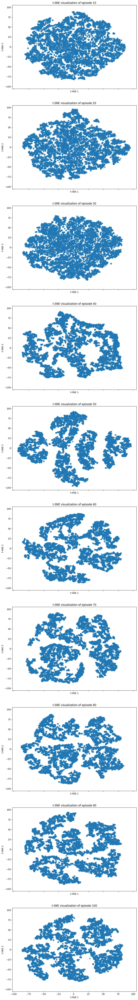

In [25]:
visualize_embeddings_evolution(sa_evolution[:10], "State-Action Embeddings Evolution", "State-Action Embeddings Evolution.png", n_samples=10000)

# test

In [ ]:
state = env.reset()[0]
action = np.random.uniform(-1, 1, size=env.action_space.shape[0])
state_dim = state.shape[0]
action_dim = env.action_space.shape[0]
    
state_action_model, action_model = load_embedding_models(state_dim, action_dim)
    
# load the embeddings
state_action_embeddings = np.load("./embeddings/state_action_embeddings.npy")
action_embeddings = np.load("./embeddings/action_embeddings.npy")
    
# Get embeddings
sa_embedding = get_state_action_embedding(state, action, state_action_model)
a_embedding = get_action_embedding(action, action_model)

In [ ]:
if sa_embedding in state_action_embeddings:
    

In [ ]:
state_action_embeddings.shape

In [ ]:
example_usage()